# Fast front-prop

Fast front-prop implementation on matrices (see original `front-prop` idea in original notebook).
This one is ~100x faster, by parallelising all neurons in the layer.

In [144]:
import numpy as np
import matplotlib.pyplot as plt
import math
import scipy
from scipy.spatial import distance
from sklearn.metrics import mean_squared_error
import torch
import torch.nn as nn
import torch.nn.functional as F
from tqdm.autonotebook import tqdm



In [152]:
np.set_printoptions(formatter={'float': lambda x: "{0:0.2f}".format(x)})


In [153]:
"""
Calculate discrete entropy for continuous values, by binning them.
Note this is Shannon's measure of information entropy.
Not cross-entropy loss, used commonly in training.
"""
def entropy(numbers, range=(0, 1), bins=100):
    h, bin_edges = np.histogram(numbers, bins=bins, density=False, range=range)
    h = h / h.max() # normalise
    entropy = scipy.stats.entropy(h)
    return entropy


In [166]:
class FastLayer:
    """
    Fast implementation of front-prop. 
    Original was done with each Neuron being separate class and using for loops.
    This implementation uses a single matrix for all neurons (neurons x input).
    Weight and threshold updates are done for all neurons in parallel, but still for single input.
    TODO: When layer is frozen, it is possible to do inference in mini-batches (many inputs in parallel).
    """
    
    T_DECAY_DEFAULT = 0.0005
    W_BOOST_DEFAULT = 0.02
    
    def __init__(self, input_size, output_size, t_decay=T_DECAY_DEFAULT, w_boost=W_BOOST_DEFAULT, init=np.random.rand):
        self.input_size = input_size
        self.output_size = output_size
        self.t_decay = t_decay
        self.w_boost = w_boost
        self.frozen = False
        
        assert self.t_decay > 0        
        assert self.w_boost > 0
        
        # LAYER PARAMETERS:
        
        # input_size = number of synapses (weights) of each neuron
        # output_size = number of neurons in the layer
        self.W = init(output_size, input_size)
        self.t = np.ones(output_size)
        
        self.reset_output()
        
        self.__assert()
        
    def __assert(self):
        assert self.W.shape == (self.output_size, self.input_size)
        assert self.t.shape == (self.output_size,)
        
        assert self.signals.shape == (self.output_size,)
        assert self.excitations.shape == (self.output_size,)
        assert self.outputs.shape == (self.output_size,)
    
    def reset_output(self):
        self.signals = np.zeros(self.output_size) # raw activation values
        self.excitations = np.zeros(self.output_size) # 1 if above threshold, else 0
        self.outputs = np.zeros(self.output_size) # normalised activation values (across whole layer)
        self.__assert()
    
    def freeze(self):
        """Disable updates to parameters and only do inference."""
        print(f'Freezing all {self.output_size} neurons')
        self.frozen = True
            
    def unfreeze(self):
        print(f'Unfreezing all {self.output_size} neurons')
        self.frozen = False
    
    def __mse(self, data_vector):
        """Mean square error between weights and input data - for all neurons in parallel."""
        assert data_vector.shape == self.W.shape

        result = self.W - data_vector
        result = np.multiply(result, result)
        result = np.sum(result, axis=1)
        result /= self.input_size

        assert result.shape == (self.output_size,)
        return result
    
    def __get_weights_boost(self, data_vector):
        """
        Get a delta vector for weights - how to shift them in space. Computes for all neurons in parallel.
        Current approach is to move weights vector towards data vector by a constant fraction
        (w_boost - similar to learning rate) of the distance between them.
        But other approaches were tried and worked too (e.g. scaled element-wise multiply by input)
        """
        assert data_vector.shape == self.W.shape
        
        w_boost = self.w_boost * (data_vector - self.W)
        
        # only boost weights in excited neurons: 
        excited_filter = np.tile(self.excitations, (self.input_size, 1)).T
        assert excited_filter.shape == self.W.shape
        w_boost = w_boost * excited_filter
            
        assert w_boost.shape == self.W.shape
        
        return w_boost
        
    def forward(self, data):
        
        self.reset_output()
        
        # replicate data for each neuron so we can do all in parallel.
        data_vector = np.tile(data, (self.output_size, 1))
        
        # activation (signal) is 1/MSE between data and weight.
        # but other appraoches work too e.g. logistic(inner product) - see original notebook.
        self.signals = 1.0 / self.__mse(data_vector)
        
        # "boolean" (0 or 1) whether neuron was excited (signal crossed threshold)
        self.excitations = 0.0 + (self.signals >= self.t) 

        if not self.frozen:
            # update weights:
            self.W = self.W + self.__get_weights_boost(data_vector)
            # update thresholds:
            # if crossed the threshold (excited neuron), then bump threshold to the new level
            self.t = self.excitations * self.signals + (1.0 - self.excitations) * self.t
            # decay all thresholds
            self.t = self.t * (1.0 - self.t_decay)

        # normalise layer outputs:
        #   TODO - try Hinton's normalisation - by vector length
        self.outputs = self.signals / self.signals.max()
        
        self.__assert()
        
        return self.outputs        
        
    def batch_forward(self, batch):
        """When frozen, threshold does not need to be updated, so can inference multiple inputs in parallel."""
        assert self.frozen
        # TODO
        raise "TODO"
        self.__assert()
        return self.outputs
        
    def draw(self, dims):
        """Draw neuron's weights."""
        print("Neurons' weights:")
        plot_matrix(dims, *([self.W[i] for i in range(self.output_size)]))
        
    def stats(self):
        weights_entropy = [entropy(self.W[i]) for i in range(self.output_size)]
        return {
            'excited_count': np.count_nonzero(self.excitations),
            'output_std': np.std(self.outputs),
            'output_min': self.outputs.min(),
            'output_max': self.outputs.max(),
            'output_avg': self.outputs.mean(),
            'output_entropy': entropy(self.outputs),
            'avg_weights_entropy': np.mean(weights_entropy),
            'std_weights_entropy': np.std(weights_entropy)
        }
    

In [169]:
from collections import deque

class TrailingStats:
    """
    Records stats and plots them
    """
    def __init__(self, maxsize=None):
        self.q = deque(maxlen=maxsize)
        self.maxsize = maxsize
        self.var_names = set()
        
    """
    data - dictionary of string -> number
    """
    def put(self, data):
        self.q.append(data)
        self.var_names.update(data.keys())
        
    def __len__(self):
        return len(self.q)
        
    def report(self):
        for n in self.var_names:
            values = np.empty(len(self))
            for i, d in enumerate(self.q):
                values[i] = d.get(n, np.nan)
            plt.xlim([0, len(self)])
            minv, avgv, maxv = (round(np.nanmin(values), 2), 
                                round(np.nanmean(values), 2), 
                                round(np.nanmax(values), 2))
            plt.title(f"{n}: min={minv}, avg={avgv}, max={maxv}")
            plt.plot(values, label=n)
            plt.show()

## Simple patterns

In [170]:
# Define input patterns

DIMS = [7,7]

patterns = np.array([
    np.array([
        [1,0,0,0,0,0,1],
        [0,1,0,0,0,1,0],
        [0,0,1,0,1,0,0],
        [0,0,0,1,0,0,0],
        [0,0,1,0,1,0,0],
        [0,1,0,0,0,1,0],
        [1,0,0,0,0,0,1]
    ]),
    np.array([
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0],
        [1,1,1,1,1,1,1],
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0]
    ]),
    np.array([
        [0,0,1,1,1,0,0],
        [0,1,0,0,0,1,0],
        [1,0,0,0,0,0,1],
        [1,0,0,0,0,0,1],
        [1,0,0,0,0,0,1],
        [0,1,0,0,0,1,0],
        [0,0,1,1,1,0,0]
    ]),
    np.array([
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0]
    ]),
    np.array([
        [1,1,1,0,0,0,0],
        [1,1,1,0,0,0,0],
        [1,1,1,0,0,0,0],
        [0,0,0,0,0,0,0],
        [0,0,0,0,0,0,0],
        [0,0,0,0,0,0,0],
        [0,0,0,0,0,0,0]
    ])
# np.array([
# [0,1,1,0],
# [1,0,0,1],
# [1,0,0,1],
# [0,1,1,0]
# ])
])

# Define probabilities

probs = np.full(len(patterns), 1) # np.array([0.43 0.43 0.13])
probs = probs / probs.sum()



In [171]:
# plot the 2D matrix heatmap
# supports a 2D array, or flattened (uses DIMS to restore 1D to 2D)
def plot_matrix(dims, *datas):
    PLOTS_PER_ROW = 20
    cols = min(len(datas), PLOTS_PER_ROW)
    rows = math.ceil(len(datas)/PLOTS_PER_ROW)
    fig = plt.figure(figsize=(cols,rows))
    for i, data in enumerate(datas):
        if data.shape != dims:
            data = np.reshape(data, dims)
        fig.add_subplot(rows, cols, i+1)
        plt.imshow(data, cmap='gray')
        plt.axis('off')
        # plt.title(f"#{i}")
    plt.show()


----------------
Running frontprop on following patterns:


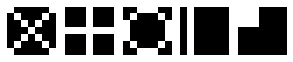

with probabilities:
[0.20 0.20 0.20 0.20 0.20]



 --- Iter #0 --- 
Neurons' weights:


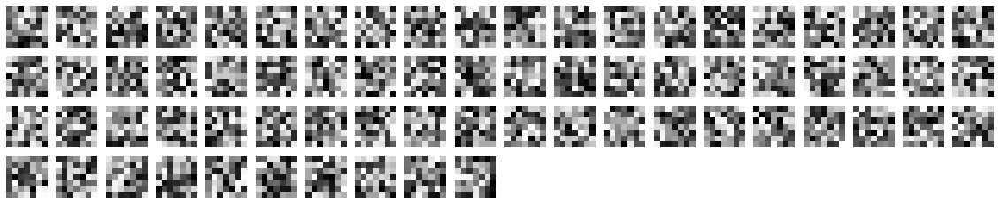

Layer outputs:
[0.81 0.67 0.99 0.85 0.82 0.78 0.71 0.66 0.77 0.75 0.60 1.00 0.72 0.74
 0.80 0.86 0.70 0.91 0.73 0.75 0.84 0.66 0.90 0.62 0.79 0.86 0.58 0.83
 0.81 0.79 0.84 0.95 0.72 0.86 0.71 0.89 0.70 0.87 0.68 0.70 0.65 0.79
 0.75 0.73 0.69 0.74 0.68 0.61 0.68 0.85 0.72 0.76 0.70 0.84 0.79 0.62
 0.68 0.73 0.68 0.72 0.69 0.76 0.82 0.90 0.63 0.96 0.70 0.65 0.77 0.77]

 --- Iter #200 --- 
Neurons' weights:


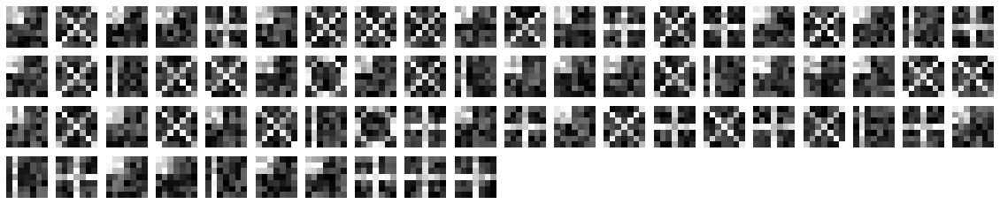

Layer outputs:
[0.18 0.79 0.18 0.18 0.13 0.18 0.79 0.78 0.84 0.18 0.76 0.18 0.13 0.94
 0.12 0.17 0.83 0.18 0.18 0.14 0.17 0.75 0.19 0.72 0.84 0.20 0.15 0.17
 0.92 0.17 0.18 0.19 0.18 1.00 0.18 0.17 0.19 0.19 0.99 0.74 0.16 0.89
 0.17 0.98 0.18 0.83 0.18 0.14 0.12 0.17 0.13 0.18 0.87 0.13 0.96 0.12
 0.85 0.18 0.13 0.18 0.18 0.13 0.19 0.18 0.17 0.17 0.17 0.12 0.13 0.13]

 --- Iter #400 --- 
Neurons' weights:


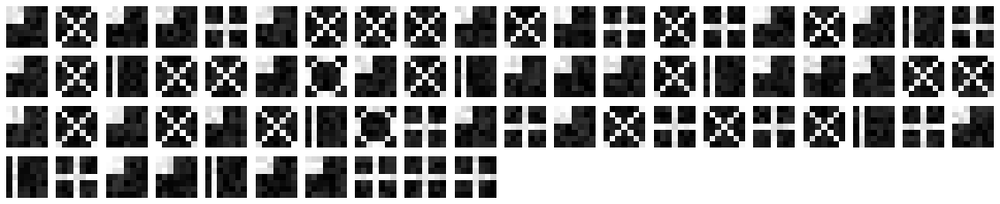

Layer outputs:
[0.02 0.02 0.02 0.02 0.64 0.02 0.02 0.02 0.02 0.02 0.02 0.02 0.58 0.02
 1.00 0.02 0.02 0.02 0.03 0.65 0.02 0.02 0.03 0.02 0.02 0.02 0.02 0.02
 0.02 0.03 0.02 0.02 0.02 0.02 0.03 0.02 0.02 0.02 0.02 0.02 0.02 0.02
 0.02 0.02 0.02 0.02 0.03 0.02 0.61 0.02 0.62 0.02 0.02 0.72 0.02 0.64
 0.02 0.03 0.68 0.02 0.03 0.60 0.02 0.02 0.03 0.02 0.02 0.56 0.63 0.74]

 --- Iter #600 --- 
Neurons' weights:


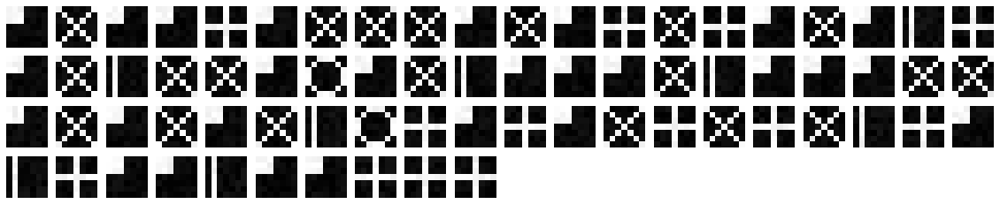

Layer outputs:
[0.81 0.01 0.95 0.81 0.00 0.75 0.01 0.01 0.01 0.72 0.00 1.00 0.00 0.00
 0.00 0.82 0.01 0.87 0.01 0.00 0.80 0.01 0.01 0.01 0.01 0.84 0.00 0.81
 0.01 0.01 0.81 0.91 0.75 0.01 0.01 0.85 0.75 0.83 0.00 0.01 0.62 0.01
 0.72 0.00 0.66 0.01 0.01 0.00 0.00 0.82 0.00 0.72 0.00 0.00 0.01 0.00
 0.00 0.01 0.00 0.73 0.01 0.00 0.81 0.94 0.01 0.92 0.74 0.00 0.00 0.00]

 --- Iter #800 --- 
Neurons' weights:


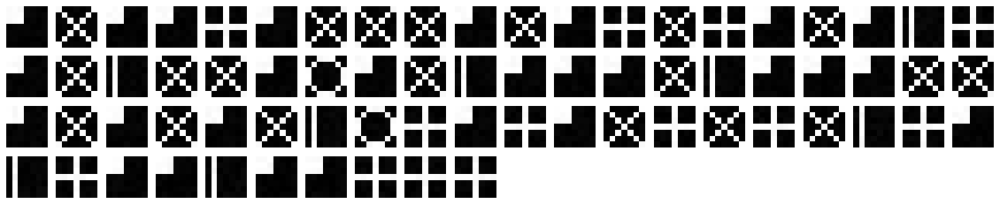

Layer outputs:
[0.00 0.00 0.00 0.00 0.64 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.58 0.00
 1.00 0.00 0.00 0.00 0.00 0.65 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
 0.00 0.00 0.00 0.00 0.00 0.00 0.61 0.00 0.62 0.00 0.00 0.72 0.00 0.64
 0.00 0.00 0.68 0.00 0.00 0.60 0.00 0.00 0.00 0.00 0.00 0.56 0.63 0.74]


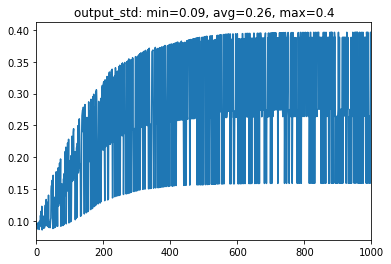

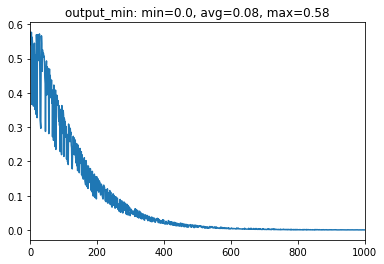

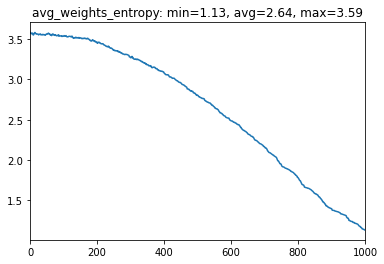

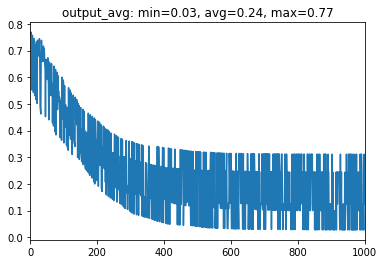

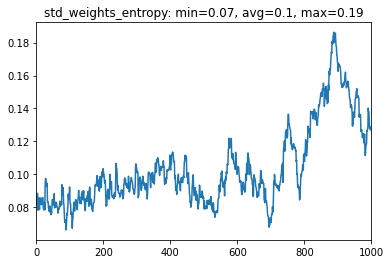

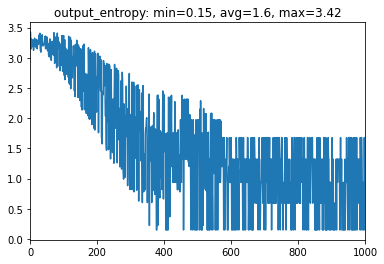

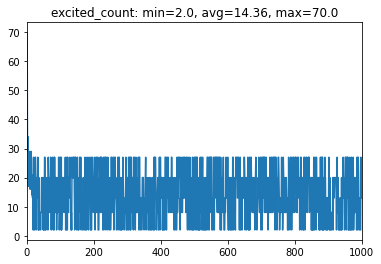

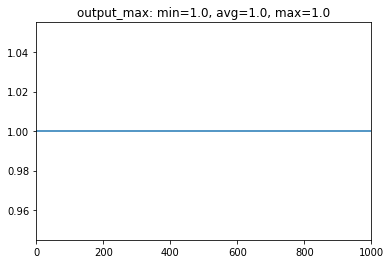

In [172]:
ITERS = 1000 # 50000
NEURONS = 70
DRAW_INTERVAL = 200 # 2000
VERBOSE=False

layer = FastLayer(DIMS[0]*DIMS[1], NEURONS)
stats = TrailingStats()

print("\n----------------\nRunning frontprop on following patterns:")
plot_matrix(DIMS, *patterns)
print(f"with probabilities:\n{probs}\n\n")

for i in range(ITERS):

    input_idx = np.random.choice(len(probs), p=probs)
    input = patterns[input_idx].flatten()
    
    if VERBOSE:
        print(f"Iter #{i}: Feeding input pattern #{input_idx}")
        print(input)
        plot_matrix(input)
        
    out = layer.forward(input)
    stats.put(layer.stats())
    
    if i % DRAW_INTERVAL == 0:
        print(f"\n --- Iter #{i} --- ")
        layer.draw(DIMS)
        print("Layer outputs:")
        print(out)
        
stats.report()

## MNIST

In [173]:
import torchvision
import torchvision.datasets as datasets

mnist_trainset = datasets.MNIST(root='./data', train=True, download=True, transform=None)

mnist_data = mnist_trainset.train_data.cpu().detach().numpy()
# normalise to 0-1
mnist_data = mnist_data / 256.0

mnist_labels = mnist_trainset.train_labels.cpu().detach().numpy()


----------------
Running frontprop on MNIST


  0%|                                                                                                                                                | 0/60000 [00:00<?, ?it/s]


 --- Iter #0 --- 
Neurons' weights:


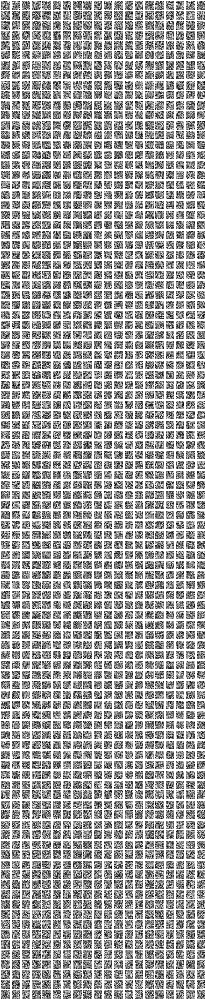

  0%|                                                                                                                                    | 5/60000 [01:08<170:26:02, 10.23s/it]

Layer1 outputs:
[0.86 0.88 0.91 ... 0.94 0.88 0.87]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [29:20<00:00, 34.09it/s]


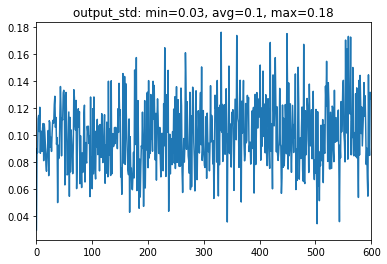

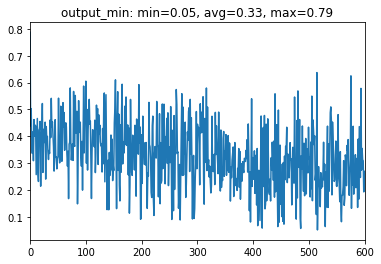

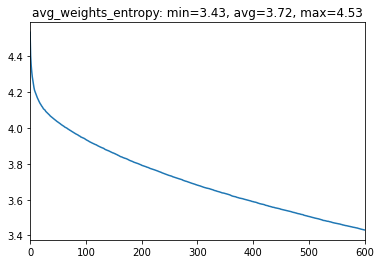

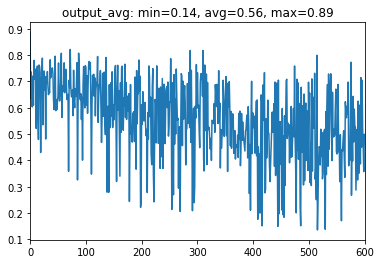

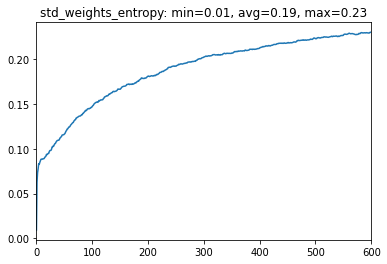

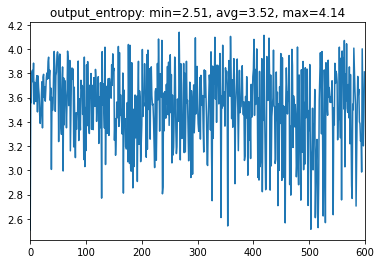

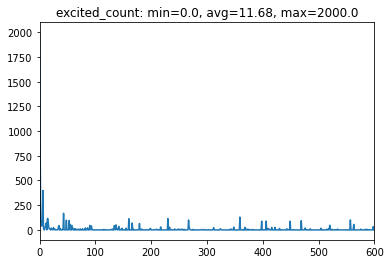

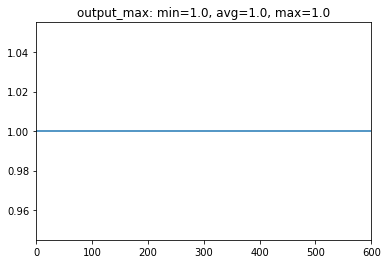

In [174]:
ITERS = 120000
NEURONS = 2000
THRESHOLD_DECAY=0.0001
WEIGHT_BOOST=0.01

DIMS = [28, 28]
VERBOSE = False
DRAW_INTERVAL = 60000
STATS_INTERVAL = 100

layer1 = FastLayer(DIMS[0]*DIMS[1], NEURONS, THRESHOLD_DECAY, WEIGHT_BOOST)
stats = TrailingStats()

print("\n----------------\nRunning frontprop on MNIST")

indices = np.arange(mnist_data.shape[0])
np.random.shuffle(indices)
for i, input_idx in enumerate(tqdm(indices)):
    
    # normalise to 0-1
    input1 = mnist_data[input_idx].flatten()
          
    out1 = layer1.forward(input1)
    
    if i % STATS_INTERVAL == 0:
        stats.put(layer1.stats())
    
    if i % DRAW_INTERVAL == 0:
        print(f"\n --- Iter #{i} --- ")
        layer1.draw(DIMS)
    
        print("Layer1 outputs:")
        print(out1)

stats.report()  

Neurons' weights:


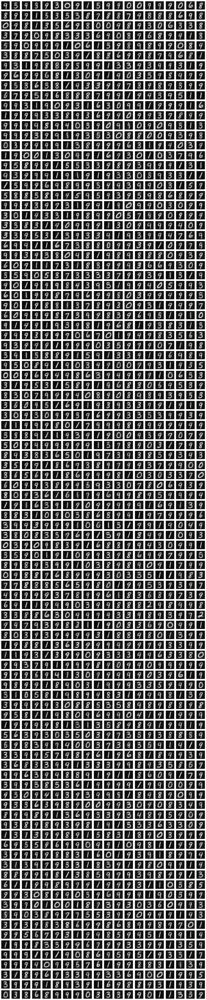

In [175]:
layer1.draw(DIMS)

## TEST

### PCA
Use PCA to visualise whether the network outputs cluster well, for some randomly chosen test data.

In [176]:
# Get network outputs for bunch of samples 

TEST_SET_SIZE=6000

# layer outputs for mnist samples
X = []
# labels
y = []

layer1.freeze()
#layer1.draw()

for i in tqdm(range(TEST_SET_SIZE)):
    sample_idx = np.random.randint(0, len(mnist_data))
    digit = mnist_labels[sample_idx]
    features = mnist_data[sample_idx].flatten()
            
    output = layer1.forward(features)
    
    X.append(output)
    y.append(digit)
    
layer1.unfreeze()

Freezing all 2000 neurons


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6000/6000 [01:02<00:00, 95.89it/s]

Unfreezing all 2000 neurons


In [177]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn import metrics

pca = PCA(n_components=2)

pca_features = pca.fit_transform(X)



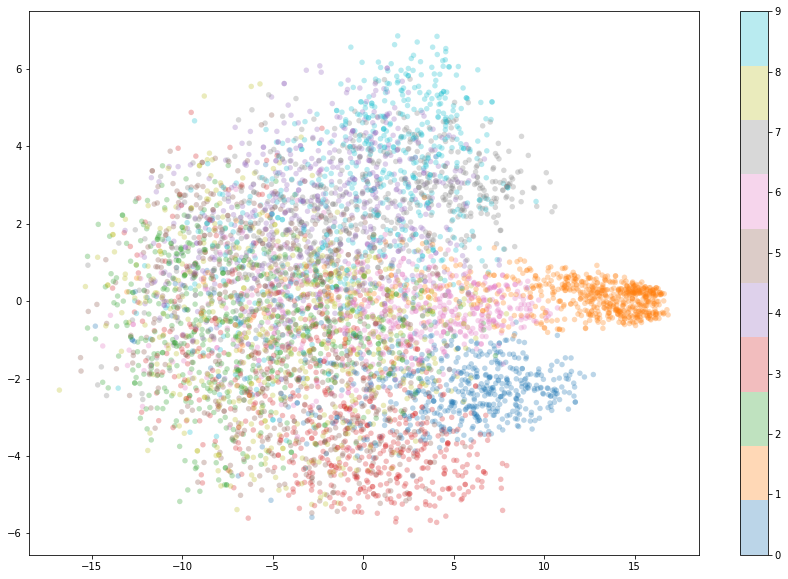

In [178]:
plt.figure(figsize=(15,10))
plt.scatter(pca_features[:, 0], pca_features[:, 1],
            c=y, edgecolor='none', alpha=0.3,
            cmap=plt.cm.get_cmap('tab10', 10), s=30)
# plt.xlabel('component 1')
# plt.ylabel('component 2')
plt.colorbar();
plt.show()


## KNN
TODO:
Cluster outputs using KNN, similarly to PCA above.


### Log Reg

This is similar to the benchmark used in Geoffrey Hinton's paper ("forward-forward", see [here](https://www.cs.toronto.edu/~hinton/FFA13.pdf)).
Treat outputs as embeddings and train a simple multi-class Log Reg on them.

Results can then be compared with other self-supervised networks, incl the "forward-forward" above.

In [179]:
# first collect outputs for all MNIST samples

layer1.freeze()
# layer1.draw()

mnist_embeddings = np.array([layer1.forward(sample.flatten()) for sample in tqdm(mnist_data)])
print(mnist_embeddings.shape)
    
layer1.unfreeze()

Freezing all 2000 neurons


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [09:49<00:00, 101.73it/s]


(60000, 2000)
Unfreezing all 2000 neurons


In [195]:
# standard preprocessing (0 mean, 1 variance) before we feed into LogReg - helps to converge

from sklearn import preprocessing
import numpy as np

mnist_embeddings_scaled = preprocessing.StandardScaler().fit_transform(mnist_embeddings)

(mnist_embeddings_scaled.min(), mnist_embeddings_scaled.mean(), mnist_embeddings_scaled.max())

(-2.507805926542909, -7.036457342716555e-17, 3.9680091899324013)

In [197]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

mnist_train, mnist_test, mnist_train_labels, mnist_test_labels = train_test_split(
    mnist_embeddings_scaled, 
    mnist_labels, 
    test_size=0.1, 
    random_state=0)

# TODO: find optimal hyper params - try out different solvers etc
logReg = LogisticRegression(n_jobs = 8, solver = 'lbfgs', multi_class="multinomial", max_iter=2000)

logReg.fit(mnist_train, mnist_train_labels)

score = logReg.score(mnist_test, mnist_test_labels)
print(score)

0.9658333333333333


# 0.9658   👀  

# (╯°□°)╯︵ ┻━┻